In [1]:
from tensorflow import keras
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import imageio
import cv2
import os

In [2]:
DATA_FOLDER = r'D:\DEEPFAKE MODEL'
TRAIN_SAMPLE_FOLDER = os.path.join(DATA_FOLDER, 'train sample videos')
TEST_FOLDER = os.path.join(DATA_FOLDER, 'test videos')

print(f"train samples: {len(os.listdir(TRAIN_SAMPLE_FOLDER))}")
print(f"test samples: {len(os.listdir(TEST_FOLDER))}")

train samples: 1288
test samples: 44


In [3]:
train_sample_metadata = pd.read_json('D:\DEEPFAKE MODEL\metadata.json').T
train_sample_metadata.head()



,label,split,original
owxbbpjpch.mp4,FAKE,train,wynotylpnm.mp4
vpmyeepbep.mp4,REAL,train,NaN
fzvpbrzssi.mp4,REAL,train,NaN
htorvhbcae.mp4,FAKE,train,wclvkepakb.mp4
fckxaqjbxk.mp4,FAKE,train,vpmyeepbep.mp4


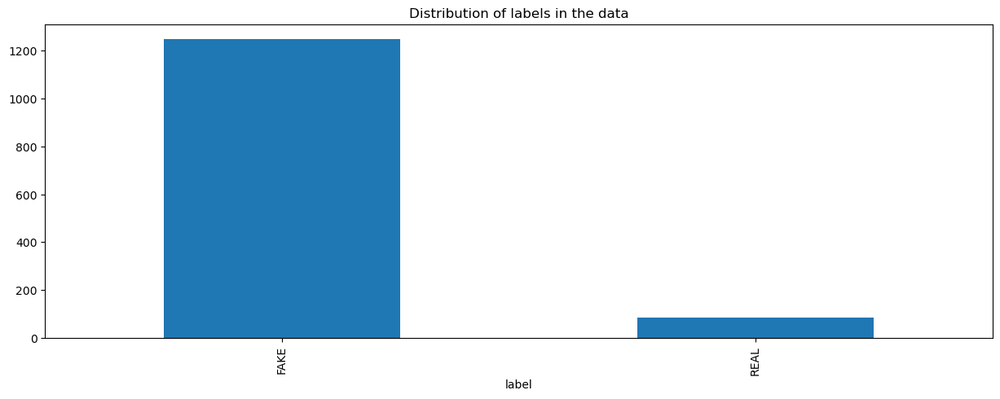

In [4]:
train_sample_metadata.groupby('label')['label'].count().plot(figsize=(15,5), kind='bar', title='Distribution of labels in the data')
plt.show()                                       

In [5]:
train_sample_metadata.shape

(1334, 3)

In [6]:
fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.label=='FAKE'].sample(10).index)
fake_train_sample_video

['inwiunnxmr.mp4',
 'atrteuctxr.mp4',
 'axbvoepbdc.mp4',
 'birmbtezni.mp4',
 'acryukkddn.mp4',
 'iyhzzwoqmi.mp4',
 'vgcwxcyiof.mp4',
 'lhipivaobq.mp4',
 'rptqbxpesg.mp4',
 'lcyjrsfrfx.mp4']

In [7]:
def display_image_from_video(video_path):
    '''
    input: video_path - path for video
    process:
    1. perform a video capture from the video
    2. read the image
    3. display the image
    '''

    capture_image = cv2.VideoCapture(video_path)
    ret, frame = capture_image. read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

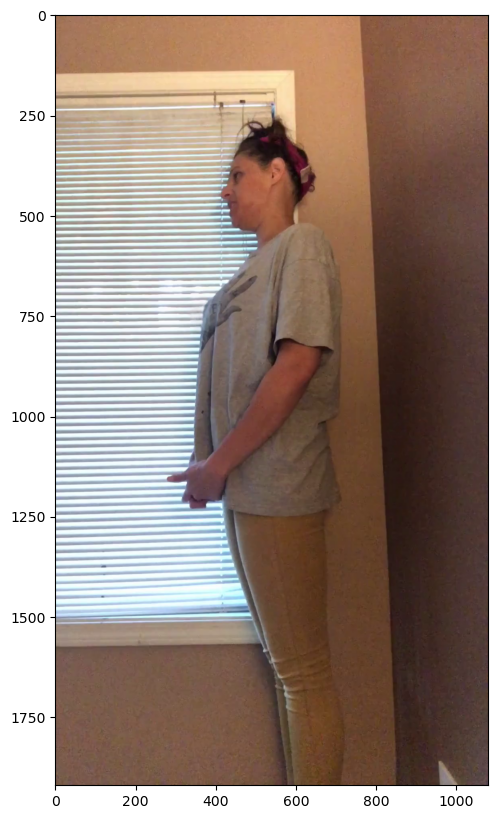

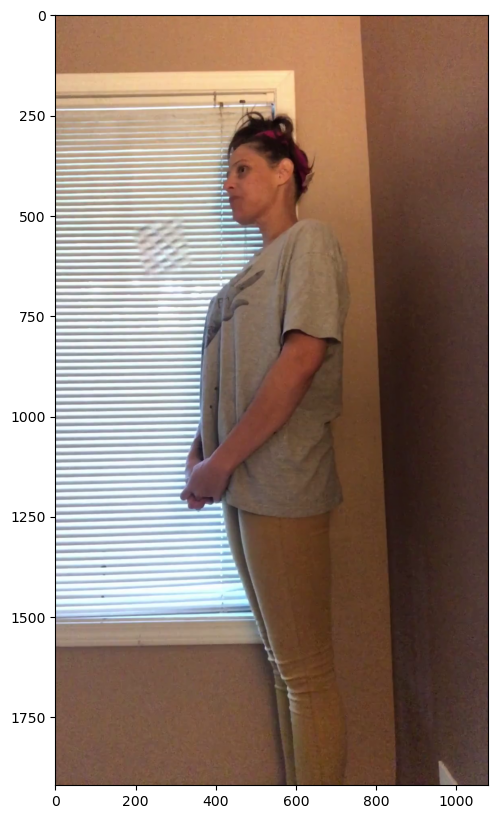

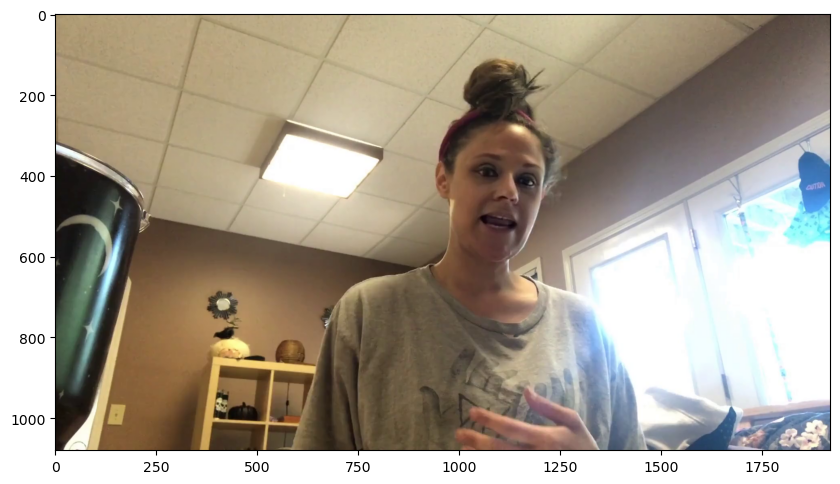

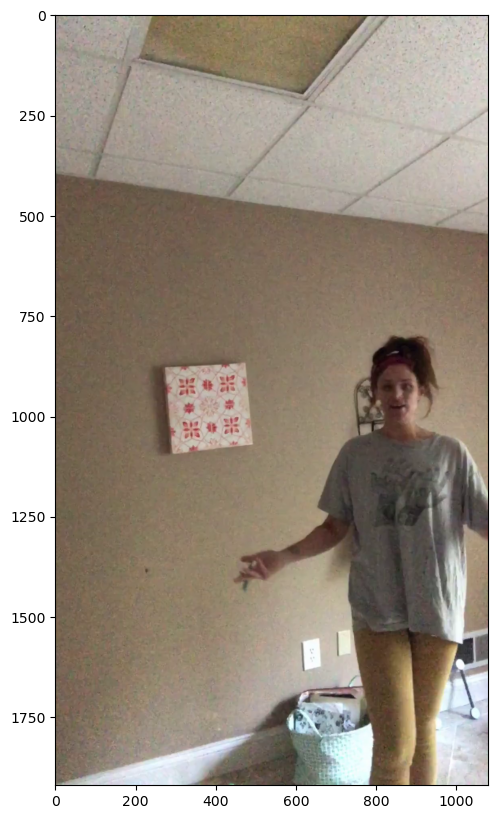

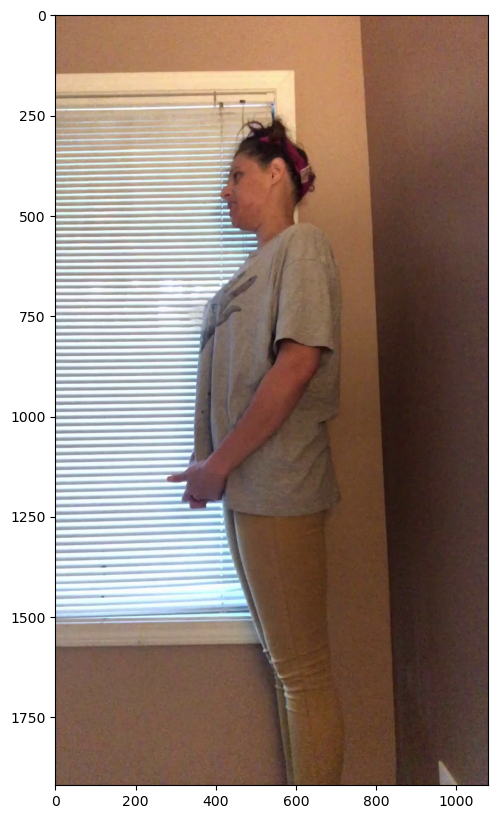

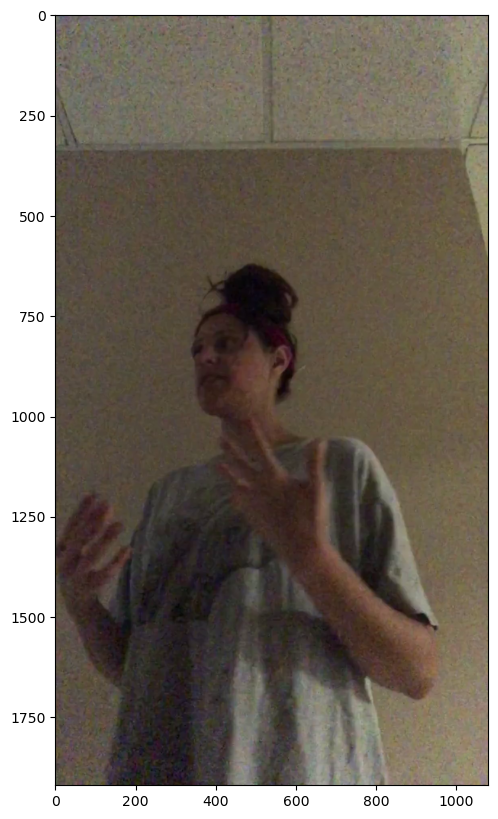

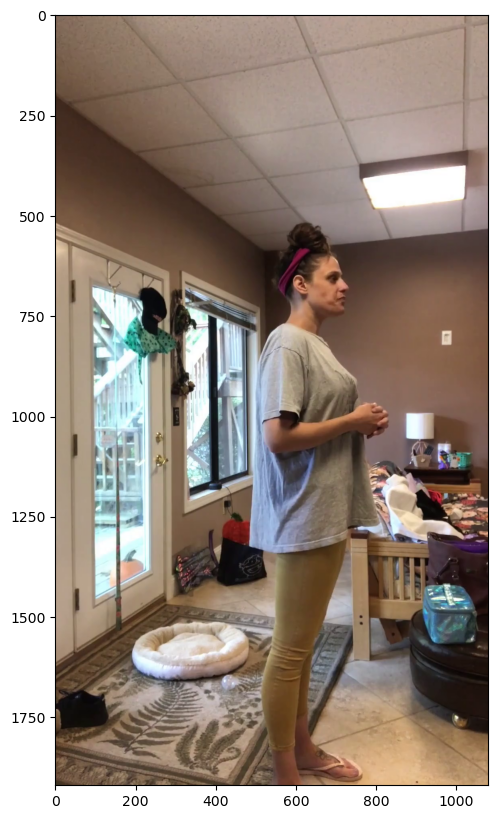

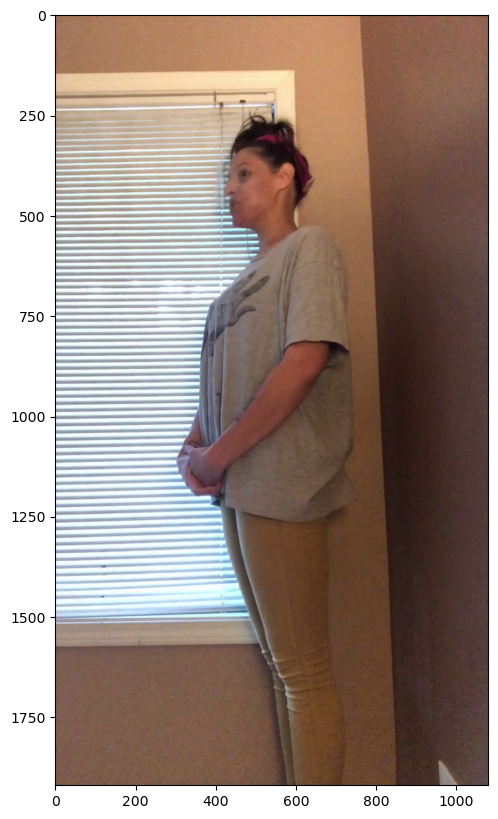

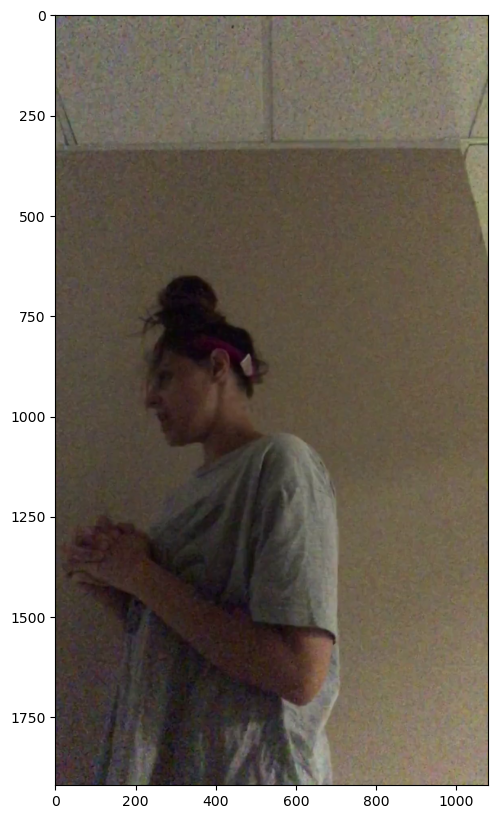

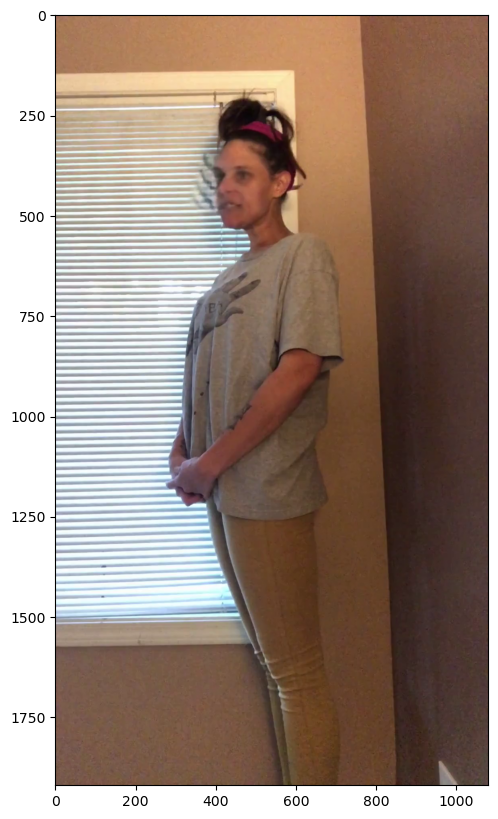

In [8]:
for video_file in fake_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

In [9]:
real_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.label=='REAL' ].sample(3).index)
real_train_sample_video

['xdezcezszc.mp4', 'rktrpsdlci.mp4', 'lnjkpdviqb.mp4']

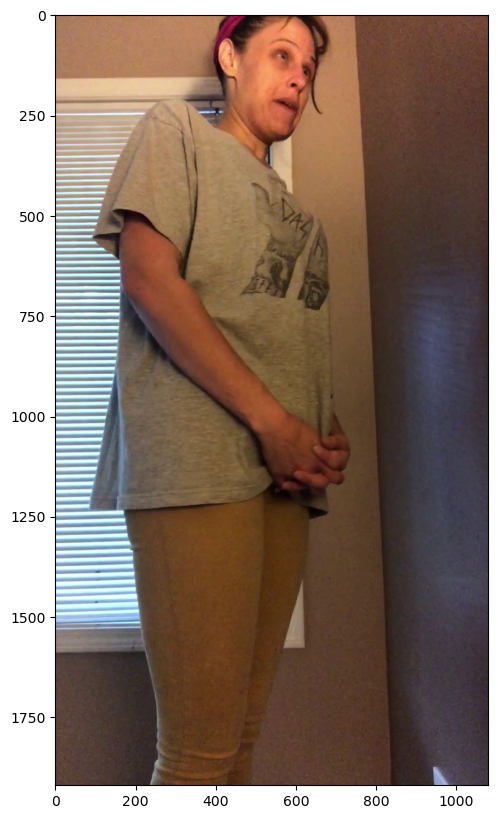

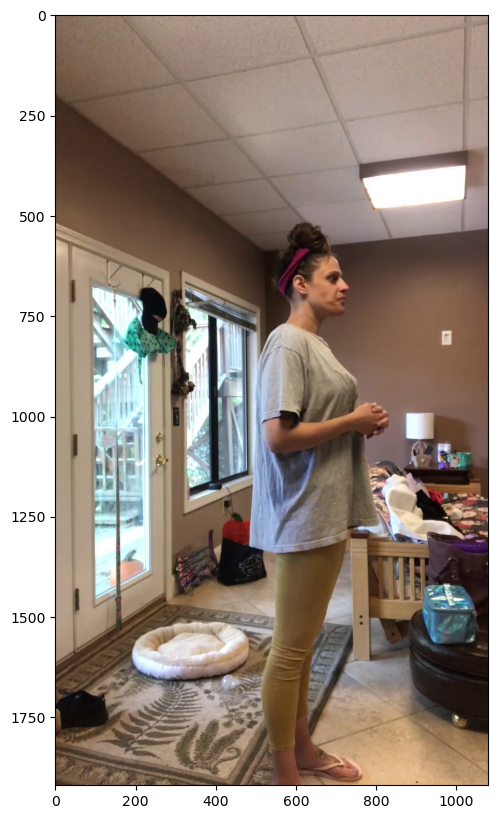

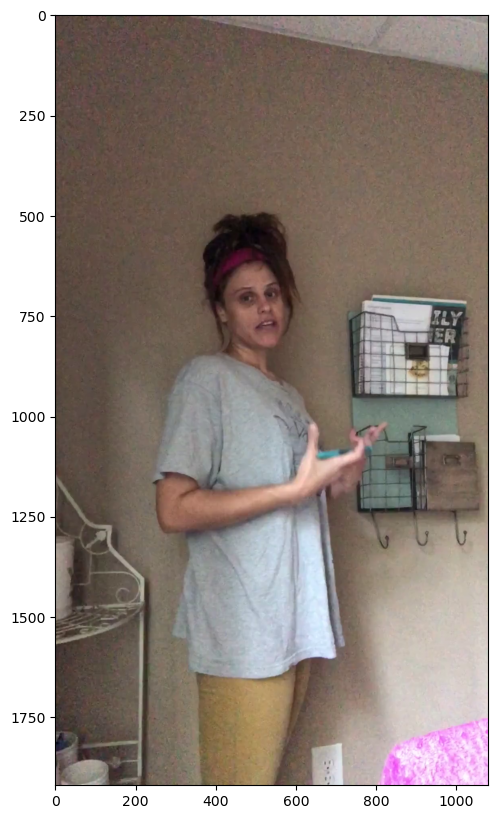

In [10]:
for video_file in real_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

In [11]:
train_sample_metadata['original'].value_counts()[0:5]

original
fdpisghkmd.mp4    36
fnslimfagb.mp4    35
wynotylpnm.mp4    34
fsaronfupy.mp4    33
uprwuohbwx.mp4    32
Name: count, dtype: int64

In [12]:
def display_image_from_video_list(video_path_list, video_folder=TRAIN_SAMPLE_FOLDER):
    '''
     input: video_path_list - path for video
     process:
     0. for each video in the video path list
        1. perform a video capture from the video
        2. read the image
        3. display the image
    '''
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    # we only show the images extracted from the first 6 video
    for i, video_file in enumerate(video_path_list[0:6]):
        video_path = os.path.join(DATA_FOLDER, video_folder,video_file)
        capture_image = cv2.VideoCapture(video_path)
        ret, frame = capture_image.read()
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        ax[i//3, i%3].imshow(frame)
        ax[i//3, i%3].set_title(f"video: {video_file}")
        ax[i//3, i%3].axis('on')

<Figure size 640x480 with 0 Axes>

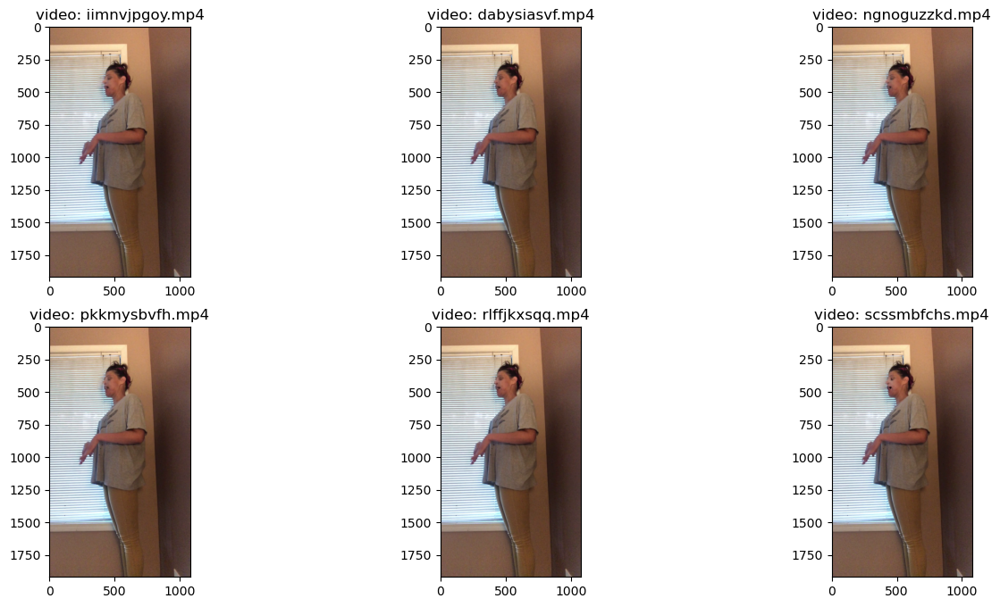

In [13]:
same_original_fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.original=='fdpisghkmd.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

In [14]:
test_videos = pd.DataFrame(list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER))), columns=['video'])

In [15]:
test_videos.head()

,video
0,zaendkbrip.mp4
1,zamdpqkmaz.mp4
2,zbmsvslybw.mp4
3,zbpwazdhtz.mp4
4,zbvlctwcqr.mp4


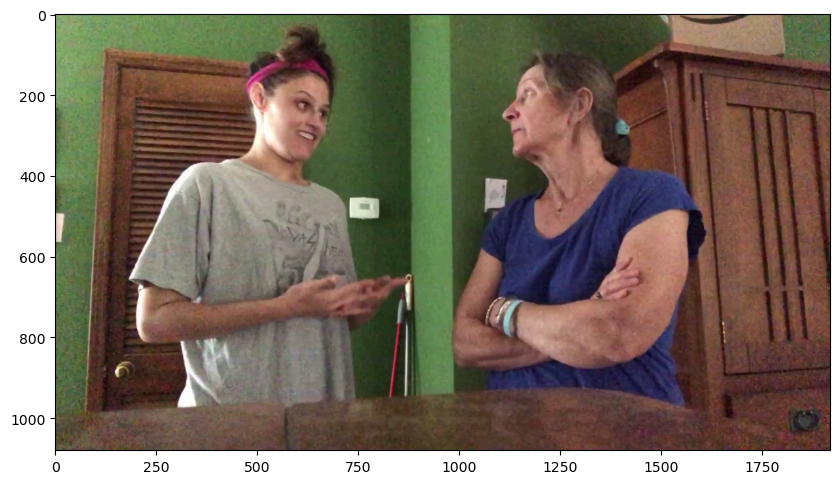

In [16]:
display_image_from_video(os.path.join(DATA_FOLDER, TEST_FOLDER, test_videos.iloc[2].video))

In [17]:
fake_videos = list(train_sample_metadata.loc[train_sample_metadata.label=='FAKE'].index)

In [18]:
from IPython.display import HTML
from base64 import b64encode

def play_video (video_file, subset=TRAIN_SAMPLE_FOLDER):
    '''
    Display video
    param: video_file the name of the video file to display
    param: subset the folder where the video file is located (can be TRAIN_SAMPLE_FOLDER or TEST_Folder)
    '''
    video_url = open(os.path.join(DATA_FOLDER, subset, video_file), 'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)
play_video(fake_videos[10])

In [19]:

IMG_SIZE = 224
BATCH_SIZE = 32
EPOCHS = 10

MAX_SEQ_LENGTH = 20
NUM_FEATURES = 2048


In [20]:
def crop_center_square (frame):
    y, x = frame.shape[0:2]
    min_dim = min(y, x)
    start_x = (x // 2) - (min_dim // 2)
    start_y = (y // 2) - (min_dim // 2)
    return frame [start_y: start_y + min_dim, start_x : start_x + min_dim]
def load_video (path, max_frames=0, resize=(IMG_SIZE, IMG_SIZE)):
    cap = cv2.VideoCapture (path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = crop_center_square (frame)
            frame = cv2.resize(frame, resize) 
            frame = frame [:, :, [2, 1, 0]]
            frames.append(frame)
            
            if len(frames) == max_frames:
                break
    finally:
        cap.release()
    return np.array(frames)

In [21]:
def build_feature_extractor():
    feature_extractor= keras.applications.InceptionV3(
        weights="imagenet",
        include_top=False,
        pooling="avg",
        input_shape=(IMG_SIZE, IMG_SIZE, 3),
)
    preprocess_input = keras.applications.inception_v3.preprocess_input
    
    inputs=keras.Input((IMG_SIZE, IMG_SIZE, 3))
    preprocessed = preprocess_input(inputs)
    
    outputs = feature_extractor (preprocessed)
    return keras. Model (inputs, outputs, name="feature_extractor")
feature_extractor= build_feature_extractor()

In [22]:
def prepare_all_videos (df, root_dir):
    num_samples = len(df)
    video_paths = list(df.index)
    labels = df["label"].values
    labels = np.array(labels=='FAKE').astype(int)
    #frame_masks and `frame_features are what we will feed to our sequence model.
    #frame_masks will contain a bunch of booleans denoting if a timestep is
    #masked with padding or not.
    frame_masks = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH), dtype="bool")
    frame_features = np.zeros(
        shape=(num_samples, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
    )
    #For each video.
    for idx, path in enumerate (video_paths):
        #Gather all its frames and add a batch dimension.
        frames = load_video(os.path.join(root_dir, path))
        frames = frames [None, ...]
        # Initialize placeholders to store the masks and features of the current video.
        
        temp_frame_mask = np.zeros (shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
        temp_frame_features = np.zeros(
            shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
        )
        # Extract features from the frames of the current video.
        for i, batch in enumerate(frames):
            video_length = batch.shape[0]
            length = min(MAX_SEQ_LENGTH, video_length)
            for j in range(length):
                temp_frame_features [i, j, :] = feature_extractor.predict( 
                    batch [None, j,:]
                )
            temp_frame_mask [i, : length] = 1 #1 = not masked, 0 masked
            
        frame_features[idx,] = temp_frame_features.squeeze()
        frame_masks[idx,] = temp_frame_mask.squeeze()
        
    return (frame_features, frame_masks), labels

In [23]:
from sklearn.model_selection import train_test_split
Train_set, Test_set = train_test_split(train_sample_metadata, test_size=0.2, random_state=42, stratify=train_sample_metadata['label'])

print(Train_set.shape, Test_set.shape)

(1067, 3) (267, 3)


In [24]:
train_data, train_labels = prepare_all_videos(Train_set, "train")
test_data, test_labels = prepare_all_videos (Test_set, "test")

print(f"Frame features in train set: {train_data[0].shape}")
print(f"Frame masks in train set: {train_data[1].shape}")

Frame features in train set: (1067, 20, 2048)
Frame masks in train set: (1067, 20)


In [25]:
    frame_features_input = keras. Input((MAX_SEQ_LENGTH, NUM_FEATURES))
    mask_input = keras. Input((MAX_SEQ_LENGTH,), dtype="bool")
    x = keras.layers.GRU (64, return_sequences=True) (frame_features_input, mask=mask_input)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.GRU (32, return_sequences=True)(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.GRU (16)(x)
    x = keras.layers.Dropout (0.5) (x) # Increased dropout
    x = keras.layers.Dense (32, activation="relu")(x)
    x = keras.layers.Dropout (0.5) (x) # Added another dropout layer
    output = keras.layers.Dense (1, activation="sigmoid")(x)
    
    model = keras.Model ([frame_features_input, mask_input], output)
    
    # Use a lower learning rate and different optimizer
    optimizer = keras.optimizers.Adam (learning_rate=1e-4)
    
    model.compile(loss="binary_crossentropy", optimizer=optimizer, metrics=["accuracy"])
    model.summary()
    
    # Include Early Stopping to prevent overfitting
    early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    checkpoint = keras.callbacks.ModelCheckpoint('./best_model.weights.h5', save_weights_only=True, save_best_only=True)
    
    history = model.fit(
        [train_data[0], train_data[1]],
        train_labels,
        validation_data=([test_data[0], test_data[1]], test_labels),
        callbacks=[checkpoint, early_stopping],
        epochs = EPOCHS,
        batch_size=16
    )    

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 20, 2048)  │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_3       │ (None, 20)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru (GRU)           │ (None, 20, 64)    │    405,888 │ input_layer_2[0]… │
│                     │                   │            │ input_layer_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 20, 64)    │        256 │ gru[0][0]         │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_1 (GRU)         │ (None, 20, 32)    │      9,408 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 20, 32)    │        128 │ gru_1[0][0]       │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_2 (GRU)         │ (None, 16)        │      2,400 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 16)        │          0 │ gru_2[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 32)        │        544 │ dropout[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 32)        │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 1)         │         33 │ dropout_1[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 418,657 (1.60 MB)

 Trainable params: 418,465 (1.60 MB)

 Non-trainable params: 192 (768.00 B)

Epoch 1/10
67/67 ━━━━━━━━━━━━━━━━━━━━ 7s 26ms/step - accuracy: 0.8608 - loss: 0.6924 - val_accuracy: 0.9363 - val_loss: 0.6902
Epoch 2/10
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.9381 - loss: 0.6895 - val_accuracy: 0.9363 - val_loss: 0.6874
Epoch 3/10
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.9254 - loss: 0.6868 - val_accuracy: 0.9363 - val_loss: 0.6845
Epoch 4/10
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.9383 - loss: 0.6837 - val_accuracy: 0.9363 - val_loss: 0.6817
Epoch 5/10
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9256 - loss: 0.6812 - val_accuracy: 0.9363 - val_loss: 0.6788
Epoch 6/10
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9347 - loss: 0.6782 - val_accuracy: 0.9363 - val_loss: 0.6760
Epoch 7/10
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9477 - loss: 0.6749 - val_accuracy: 0.9363 - val_loss: 0.6732
Epoch 8/10
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9276 - loss: 0.6730 - val_accuracy: 0.9363 - v

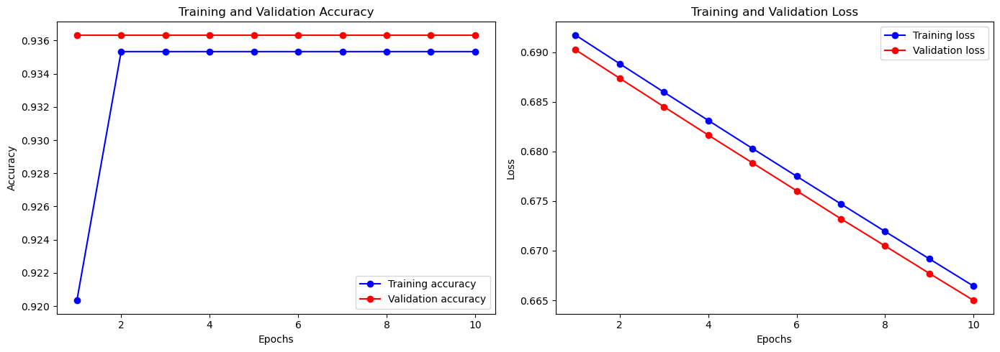

In [26]:
import matplotlib.pyplot as plt

# Extract the data from the history object
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(accuracy) + 1)

# Plot training and validation accuracy
plt.figure(figsize=(14,5))

plt.subplot(1, 2, 1)
plt.plot(epochs, accuracy, 'bo-', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'ro-', label='Validation accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
# Plot training and validation loss
plt.subplot(1, 2, 2)
plt.plot(epochs, loss, 'bo-', label='Training loss')
plt.plot(epochs, val_loss, 'ro-', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

In [27]:
print(test_videos["video"].values.tolist())

['zaendkbrip.mp4', 'zamdpqkmaz.mp4', 'zbmsvslybw.mp4', 'zbpwazdhtz.mp4', 'zbvlctwcqr.mp4', 'zccpfawquo.mp4', 'zcnslhnnhl.mp4', 'zepsangjjb.mp4', 'zfkgevlnur.mp4', 'zhkqxjalrq.mp4', 'zhopdnywsb.mp4', 'zigzhwlpcd.mp4', 'zjcpgizmgd.mp4', 'zkarzsylvk.mp4', 'zmjszxzxpz.mp4', 'zmndlwmybr.mp4', 'znxyqjeodn.mp4', 'zoleozlpfj.mp4', 'zovntpfyum.mp4', 'zpbggelffo.mp4', 'zpidqyqocx.mp4', 'zpilavstvx.mp4', 'zpllznxapc.mp4', 'zplyjqnfmv.mp4', 'zqjzmarjbk.mp4', 'zqodmfrtbs.mp4', 'zqtvyuoabj.mp4', 'zrplhkcesw.mp4', 'zrueallpey.mp4', 'zrxngesosr.mp4', 'ztwlbdwyni.mp4', 'zumqskdmht.mp4', 'zuvktiyzzr.mp4', 'zvjzhuinck.mp4', 'zvsivkdkak.mp4', 'zvuidmemcp.mp4', 'zwgrutmnsn.mp4', 'zwsbdiyrpg.mp4', 'zxprilbsxp.mp4', 'zxvgazoudy.mp4', 'zxyvcnkeiz.mp4', 'zybunacsgi.mp4', 'zyjmvauuzw.mp4', 'zzlsynxeff.mp4']


In [28]:
def prepare_single_video(frames): 
    frames = frames[None, ...]
    frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
    frame_features = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")
    
    for i, batch in enumerate(frames):
        video_length = batch.shape[0]
        length = min(MAX_SEQ_LENGTH, video_length)
        for j in range(length):
            frame_features[i, j, :] = feature_extractor.predict(batch[None, j, :])
        frame_mask[i, :length] = 1  # 1 = not masked, 0 masked

    return frame_features, frame_mask

def sequence_prediction(path):
    frames = load_video(os.path.join(DATA_FOLDER, TEST_FOLDER, path))
    frame_features, frame_mask = prepare_single_video(frames)
    return model.predict([frame_features, frame_mask])[0]

# Utility for converting frames to GIF for visualization
def to_gif(images):
    converted_images = images.astype(np.uint8)
    imageio.mimsave("animation.gif", converted_images, fps=10) 
    return embed.embed_file("animation.gif")

# Testing with a random video from test_videos
test_video = np.random.choice(test_videos["video"].values.tolist())
print(f"Test video path: {test_video}")

# Get prediction and print result
prediction = sequence_prediction(test_video)
if prediction >= 0.5:
    print(f'The predicted class of the video is FAKE')
else:
    print(f'The predicted class of the video is REAL')

# Play the video (this function needs to be defined if you want to show the video)
play_video(test_video, TEST_FOLDER)


Test video path: zmjszxzxpz.mp4
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step
The predicted class of the video is REAL


In [29]:
model.save('deepfake_video_model.h5')